In [ ]:
# !pip install alphalens-reloaded

In [6]:
import pandas as pd
import alphalens as al

In [7]:
df_factors = pd.read_parquet('tests/factors.parquet')
df_factors.dropna(inplace=True)
df_factors

open   PV_Corr  dP_P_Corr  \
date                      asset                                   
2018-01-02 08:00:00+08:00 sh.600004  14.73  0.090534   0.270058   
                          sh.600006   5.86  0.413978   0.304839   
                          sh.600017   3.88 -0.018362  -0.004690   
                          sh.600022   2.14 -0.192313  -0.095678   
                          sh.600026   6.11  0.086897   0.036088   
...                                    ...       ...        ...   
2024-05-16 08:00:00+08:00 sz.300287   2.54 -0.190364   0.079971   
                          sz.300291   4.83 -0.348482  -0.214735   
                          sz.300324   2.53 -0.186222   0.029957   
                          sz.300376   5.16 -0.384478   0.275499   
                          sz.300383   8.97 -0.392759   0.304644   

                                     dP_abs_P_Corr  dV_V_Corr  dV_abs_V_Corr  
date                      asset                                               
2018-01-02 08:00:00+08:00 sh.600004      -0.277863   0.097419       0.189974  
                          sh.600006       0.420312   0.253404       0.106000  
                          sh.600017       0.238512  -0.126166      -0.008230  
                          sh.600022      -0.109664   0.034059      -0.054035  
                          sh.600026      -0.122444   0.076649       0.092814  
...                                            ...        ...            ...  
2024-05-16 08:00:00+08:00 sz.300287      -0.182289   0.243220       0.119812  
                          sz.300291      -0.219475  -0.054340       0.085721  
                          sz.300324       0.151901   0.086165      -0.001680  
                          sz.300376       0.087942   0.175358       0.143703  
                          sz.300383       0.103883   0.151362       0.243670  

[742192 rows x 6 columns]

In [8]:
def factor_smooth(factor_series: pd.Series):
    return factor_series.groupby('asset', group_keys=False).apply(lambda x: x.rolling(20).mean())

In [9]:
df_factors.iloc[:, 1:].corr()

,PV_Corr,dP_P_Corr,dP_abs_P_Corr,dV_V_Corr,dV_abs_V_Corr
PV_Corr,1.000000,0.020246,0.529976,-0.009892,0.114041
dP_P_Corr,0.020246,1.000000,0.104088,0.043668,0.124446
dP_abs_P_Corr,0.529976,0.104088,1.000000,-0.019042,0.118530
dV_V_Corr,-0.009892,0.043668,-0.019042,1.000000,-0.180044
dV_abs_V_Corr,0.114041,0.124446,0.118530,-0.180044,1.000000


In [10]:
prices = df_factors['open'].unstack(level='asset').shift(-1)
prices

asset,sh.600004,sh.600006,sh.600017,sh.600022,sh.600026,sh.600037,sh.600039,sh.600053,sh.600056,sh.600058,...,sz.300257,sz.300266,sz.300273,sz.300274,sz.300287,sz.300291,sz.300297,sz.300324,sz.300376,sz.300383
date,,,,,,,,,,,,,,,,,,,,,
2018-01-02 08:00:00+08:00,14.84,5.88,3.91,2.17,6.20,13.07,4.12,24.01,24.94,12.09,...,14.26,26.79,9.08,19.50,7.45,NaN,9.56,14.51,7.51,NaN
2018-01-03 08:00:00+08:00,14.75,5.87,3.95,2.17,6.22,13.11,4.14,24.25,25.23,12.15,...,14.21,26.45,9.42,19.27,7.56,NaN,9.69,14.68,7.50,NaN
2018-01-04 08:00:00+08:00,14.60,5.85,3.95,2.18,6.29,13.08,4.11,24.26,25.71,12.13,...,14.24,26.68,9.29,18.90,7.46,NaN,9.54,14.49,7.46,NaN
2018-01-05 08:00:00+08:00,14.68,5.86,3.97,2.18,6.30,13.11,4.15,24.10,25.50,12.12,...,13.91,26.72,9.22,18.01,7.59,NaN,9.54,14.33,7.56,NaN
2018-01-08 08:00:00+08:00,14.46,5.92,3.98,2.21,6.32,13.06,4.20,23.87,26.14,12.30,...,14.23,26.89,9.39,17.47,7.52,NaN,9.41,14.25,7.63,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-10 08:00:00+08:00,10.25,7.12,2.90,1.29,17.07,6.80,7.60,15.34,11.38,8.07,...,12.41,1.73,NaN,104.90,2.59,4.99,NaN,2.60,5.51,9.01
2024-05-13 08:00:00+08:00,10.28,7.19,2.97,1.28,18.13,6.82,7.67,14.94,11.30,7.99,...,12.90,1.69,NaN,106.50,2.54,4.89,NaN,2.52,5.39,9.03
2024-05-14 08:00:00+08:00,10.29,7.35,2.95,1.27,17.80,6.90,7.63,15.13,11.36,8.04,...,13.02,1.70,NaN,108.89,2.55,4.89,NaN,2.53,5.26,9.07


============= PV_Corr ===========


/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to cal

Dropped 1.2% entries from factor data: 1.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.986872,0.133548,-0.542055,0.127303,73958,10.090222
2,-0.700420,0.241745,-0.360479,0.117337,73221,9.989672
3,-0.630480,0.323920,-0.255881,0.124599,73088,9.971527
4,-0.583205,0.377937,-0.171412,0.130143,73202,9.987080
5,-0.531899,0.480208,-0.095803,0.133659,73387,10.012320
6,-0.477657,0.569179,-0.022320,0.135565,72911,9.947378
7,-0.404186,0.628202,0.052944,0.135810,73081,9.970572
8,-0.329245,0.702449,0.135642,0.134652,73209,9.988035
9,-0.250257,0.757088,0.238364,0.130914,73100,9.973164


Returns Analysis


,1D,5D,20D
Ann. alpha,0.131,0.039,0.012
beta,0.011,-0.003,-0.000
Mean Period Wise Return Top Quantile (bps),6.131,1.389,-0.123
Mean Period Wise Return Bottom Quantile (bps),-7.379,-3.635,-1.616
Mean Period Wise Spread (bps),13.510,5.034,1.502


<Figure size 640x480 with 0 Axes>

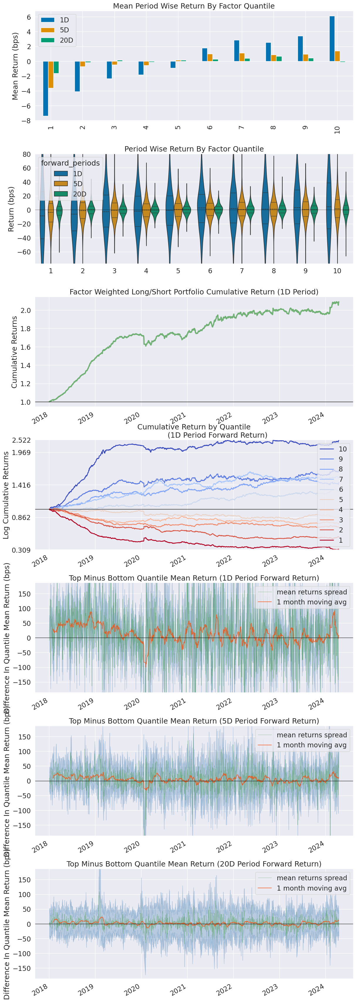

Information Analysis


,1D,5D,20D
IC Mean,0.029,0.023,0.016
IC Std.,0.103,0.095,0.094
Risk-Adjusted IC,0.280,0.242,0.170
t-stat(IC),10.914,9.441,6.621
p-value(IC),0.000,0.000,0.000
IC Skew,-0.188,-0.111,0.056
IC Kurtosis,0.454,0.697,0.726


/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


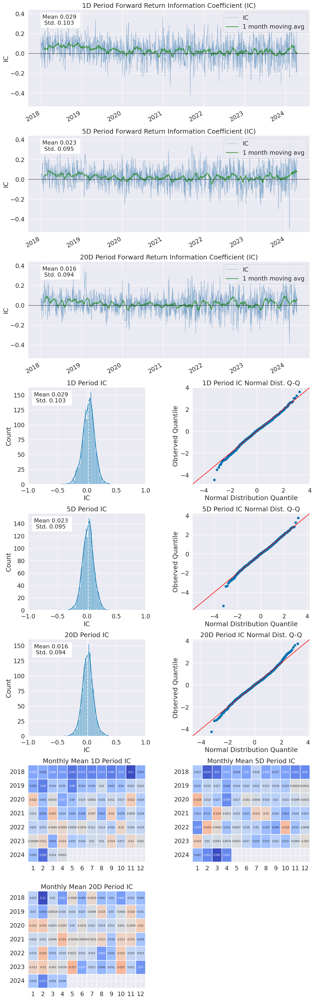

/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,20D
Quantile 1 Mean Turnover,0.869,0.881,0.889
Quantile 2 Mean Turnover,0.893,0.895,0.898
Quantile 3 Mean Turnover,0.898,0.899,0.900
Quantile 4 Mean Turnover,0.899,0.900,0.899
Quantile 5 Mean Turnover,0.897,0.896,0.900
Quantile 6 Mean Turnover,0.897,0.899,0.900
Quantile 7 Mean Turnover,0.895,0.896,0.898
Quantile 8 Mean Turnover,0.896,0.897,0.899
Quantile 9 Mean Turnover,0.895,0.897,0.900
Quantile 10 Mean Turnover,0.875,0.885,0.890


,1D,5D,20D
Mean Factor Rank Autocorrelation,0.051,0.025,0.013


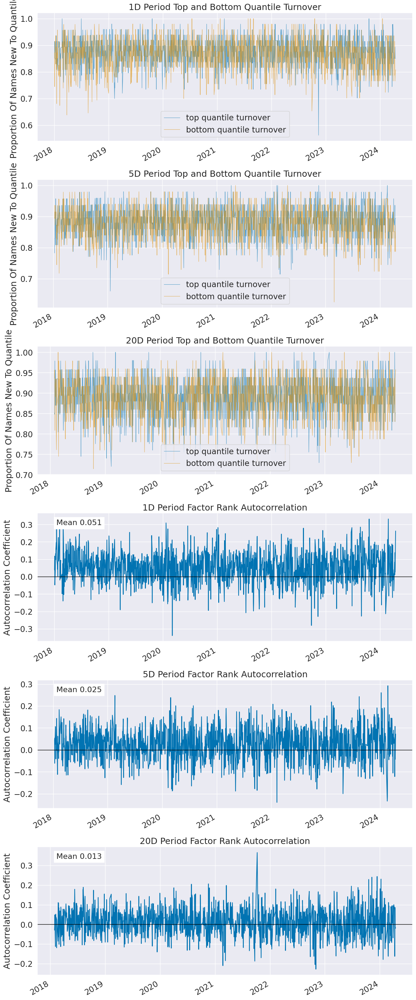

============= dP_P_Corr ===========


/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to cal

Dropped 1.2% entries from factor data: 1.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.981423,-0.099879,-0.359039,0.064424,73958,10.090222
2,-0.432576,-0.039823,-0.271995,0.035319,73221,9.989672
3,-0.377241,0.010561,-0.229276,0.034932,73088,9.971527
4,-0.337358,0.042079,-0.195519,0.036233,73202,9.987080
5,-0.314959,0.077606,-0.164473,0.038289,73387,10.012320
6,-0.286465,0.120068,-0.133600,0.040689,72911,9.947378
7,-0.267135,0.161876,-0.100262,0.043736,73081,9.970572
8,-0.243875,0.207060,-0.061097,0.047708,73209,9.988035
9,-0.212854,0.268899,-0.008811,0.053933,73100,9.973164


Returns Analysis


,1D,5D,20D
Ann. alpha,0.055,0.013,0.011
beta,-0.019,-0.005,-0.006
Mean Period Wise Return Top Quantile (bps),1.412,-0.115,0.484
Mean Period Wise Return Bottom Quantile (bps),-4.430,-1.372,-1.035
Mean Period Wise Spread (bps),5.843,1.253,1.515


<Figure size 640x480 with 0 Axes>

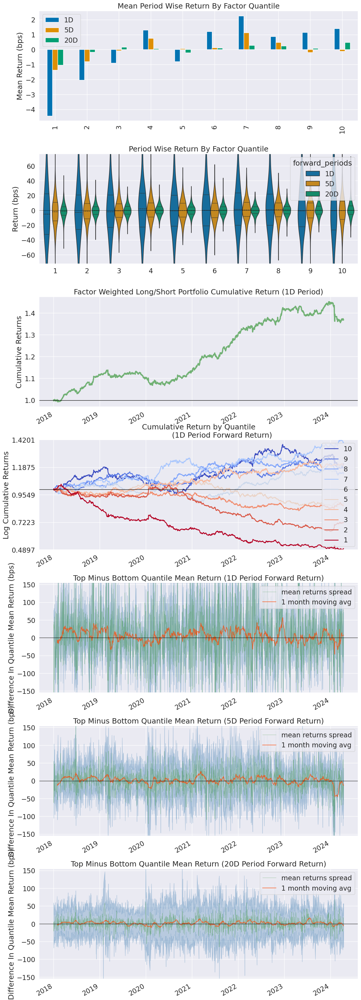

Information Analysis


,1D,5D,20D
IC Mean,0.012,0.009,0.012
IC Std.,0.089,0.087,0.081
Risk-Adjusted IC,0.131,0.108,0.149
t-stat(IC),5.095,4.232,5.805
p-value(IC),0.000,0.000,0.000
IC Skew,-0.036,0.046,-0.031
IC Kurtosis,0.860,1.124,0.352


/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


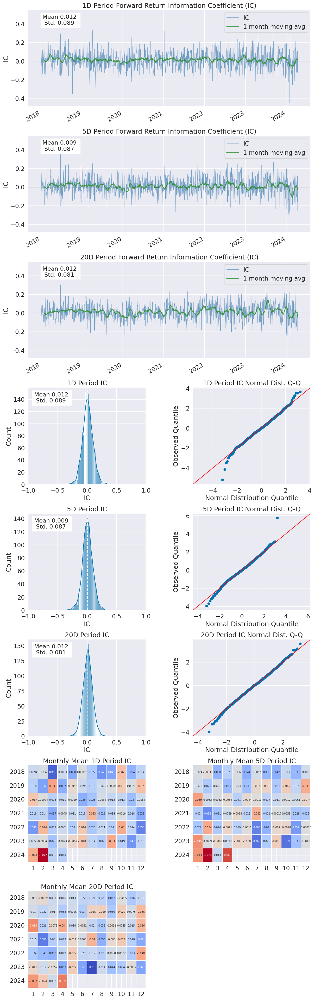

/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,20D
Quantile 1 Mean Turnover,0.882,0.885,0.887
Quantile 2 Mean Turnover,0.896,0.893,0.894
Quantile 3 Mean Turnover,0.897,0.898,0.898
Quantile 4 Mean Turnover,0.897,0.898,0.901
Quantile 5 Mean Turnover,0.900,0.900,0.898
Quantile 6 Mean Turnover,0.899,0.901,0.899
Quantile 7 Mean Turnover,0.896,0.898,0.899
Quantile 8 Mean Turnover,0.894,0.897,0.896
Quantile 9 Mean Turnover,0.892,0.893,0.893
Quantile 10 Mean Turnover,0.891,0.891,0.893


,1D,5D,20D
Mean Factor Rank Autocorrelation,0.033,0.038,0.034


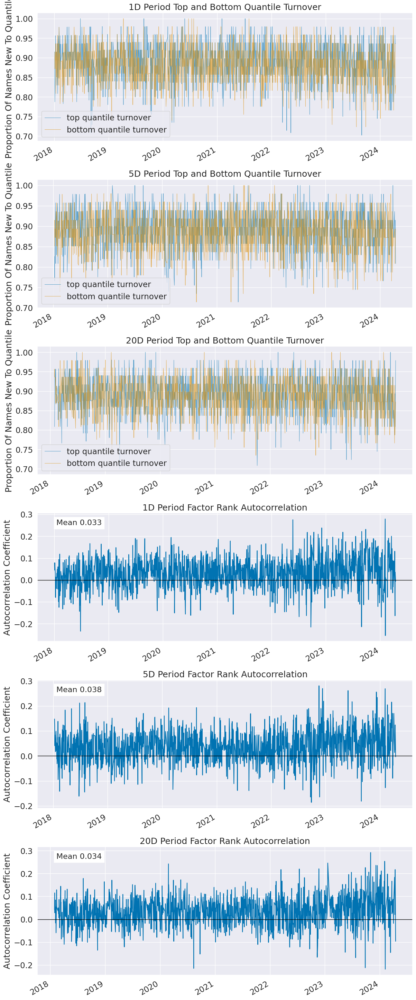

============= dP_abs_P_Corr ===========


/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to cal

Dropped 1.2% entries from factor data: 1.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.998069,-0.040047,-0.409075,0.107897,73958,10.090222
2,-0.613425,0.065231,-0.264276,0.077530,73221,9.989672
3,-0.541154,0.172695,-0.188807,0.076291,73088,9.971527
4,-0.451536,0.241366,-0.129006,0.076234,73202,9.987080
5,-0.355586,0.304886,-0.075463,0.076259,73387,10.012320
6,-0.299622,0.360441,-0.024198,0.076144,72911,9.947378
7,-0.227896,0.412882,0.028716,0.076156,73081,9.970572
8,-0.145177,0.476267,0.087678,0.076669,73209,9.988035
9,-0.093891,0.546102,0.162013,0.078203,73100,9.973164


Returns Analysis


,1D,5D,20D
Ann. alpha,0.092,0.037,0.015
beta,0.002,-0.013,-0.011
Mean Period Wise Return Top Quantile (bps),4.932,1.730,0.590
Mean Period Wise Return Bottom Quantile (bps),-4.886,-2.331,-1.196
Mean Period Wise Spread (bps),9.818,4.057,1.782


<Figure size 640x480 with 0 Axes>

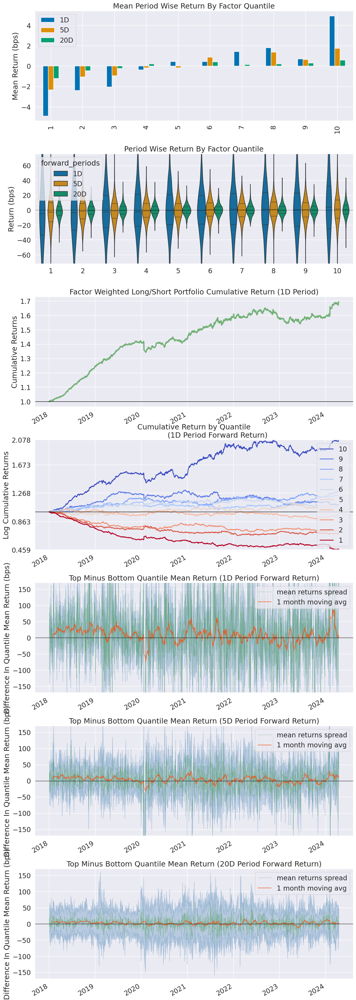

Information Analysis


,1D,5D,20D
IC Mean,0.018,0.023,0.017
IC Std.,0.085,0.082,0.081
Risk-Adjusted IC,0.217,0.278,0.211
t-stat(IC),8.471,10.843,8.223
p-value(IC),0.000,0.000,0.000
IC Skew,-0.104,-0.212,0.082
IC Kurtosis,0.887,0.774,0.804


/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


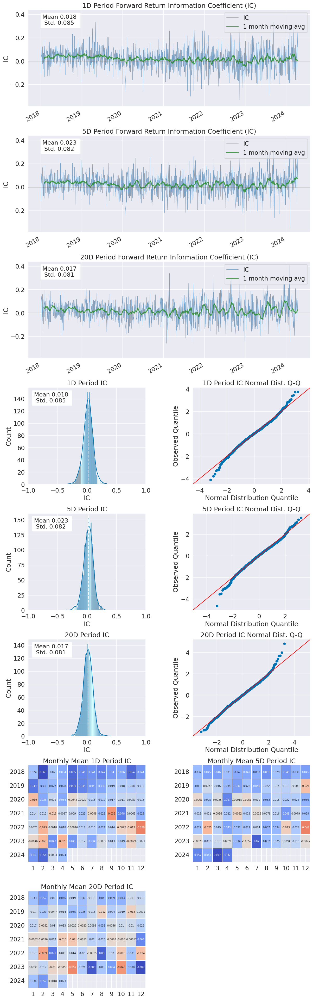

/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,20D
Quantile 1 Mean Turnover,0.874,0.882,0.888
Quantile 2 Mean Turnover,0.896,0.897,0.897
Quantile 3 Mean Turnover,0.899,0.899,0.904
Quantile 4 Mean Turnover,0.899,0.899,0.901
Quantile 5 Mean Turnover,0.901,0.900,0.899
Quantile 6 Mean Turnover,0.899,0.896,0.901
Quantile 7 Mean Turnover,0.896,0.896,0.899
Quantile 8 Mean Turnover,0.898,0.899,0.901
Quantile 9 Mean Turnover,0.896,0.896,0.900
Quantile 10 Mean Turnover,0.885,0.891,0.894


,1D,5D,20D
Mean Factor Rank Autocorrelation,0.037,0.024,0.015


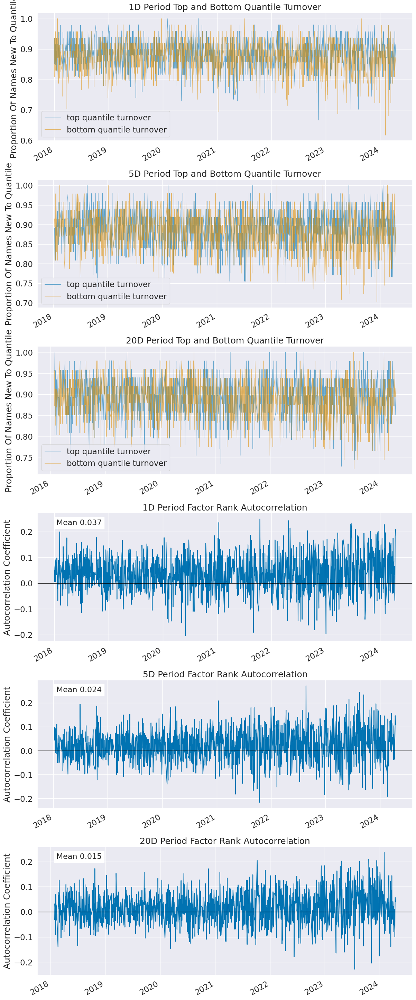

============= dV_V_Corr ===========


/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to cal

Dropped 1.2% entries from factor data: 1.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.899034,0.048617,-0.344533,0.080986,73958,10.090222
2,-0.375704,0.191096,-0.220207,0.049256,73221,9.989672
3,-0.314217,0.275148,-0.155962,0.049528,73088,9.971527
4,-0.264906,0.347999,-0.105355,0.051348,73202,9.987080
5,-0.235456,0.406271,-0.059938,0.053662,73387,10.012320
6,-0.201903,0.460865,-0.015756,0.056694,72911,9.947378
7,-0.166410,0.517181,0.031247,0.060650,73081,9.970572
8,-0.124830,0.587349,0.086217,0.066451,73209,9.988035
9,-0.076615,0.658785,0.162367,0.077085,73100,9.973164


Returns Analysis


,1D,5D,20D
Ann. alpha,0.085,0.019,0.009
beta,0.015,0.018,0.011
Mean Period Wise Return Top Quantile (bps),4.423,-0.307,-0.465
Mean Period Wise Return Bottom Quantile (bps),-4.492,-2.211,-1.553
Mean Period Wise Spread (bps),8.915,1.859,1.050


<Figure size 640x480 with 0 Axes>

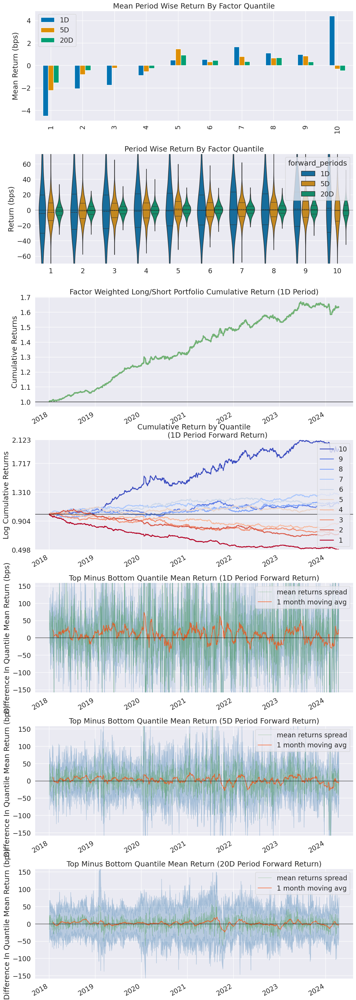

Information Analysis


,1D,5D,20D
IC Mean,0.011,0.005,0.003
IC Std.,0.074,0.072,0.069
Risk-Adjusted IC,0.152,0.069,0.050
t-stat(IC),5.946,2.708,1.956
p-value(IC),0.000,0.007,0.051
IC Skew,-0.201,-0.115,-0.169
IC Kurtosis,1.085,0.593,0.437


/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


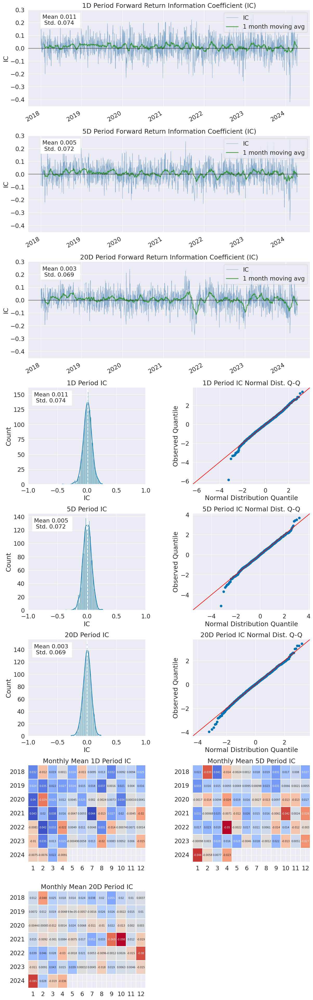

/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,20D
Quantile 1 Mean Turnover,0.893,0.886,0.890
Quantile 2 Mean Turnover,0.896,0.896,0.899
Quantile 3 Mean Turnover,0.897,0.897,0.900
Quantile 4 Mean Turnover,0.897,0.896,0.900
Quantile 5 Mean Turnover,0.897,0.900,0.901
Quantile 6 Mean Turnover,0.898,0.899,0.901
Quantile 7 Mean Turnover,0.898,0.897,0.901
Quantile 8 Mean Turnover,0.897,0.897,0.901
Quantile 9 Mean Turnover,0.898,0.897,0.898
Quantile 10 Mean Turnover,0.853,0.877,0.884


,1D,5D,20D
Mean Factor Rank Autocorrelation,0.026,0.037,0.026


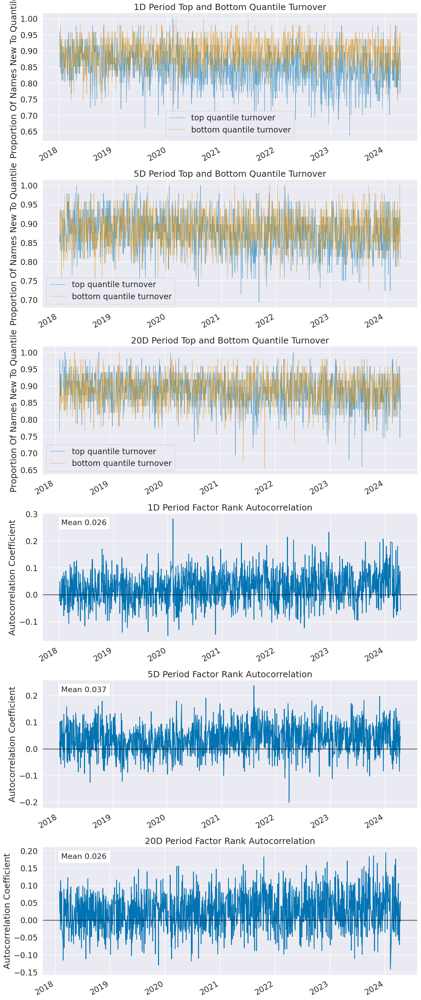

============= dV_abs_V_Corr ===========


/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to cal

Dropped 1.2% entries from factor data: 1.2% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!
Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-0.990277,-0.379335,-0.615583,0.089875,73958,10.090222
2,-0.731169,-0.284568,-0.471761,0.052325,73221,9.989672
3,-0.669396,-0.229306,-0.394296,0.049530,73088,9.971527
4,-0.613300,-0.178986,-0.332635,0.048837,73202,9.987080
5,-0.565161,-0.125524,-0.277125,0.048280,73387,10.012320
6,-0.510326,-0.071253,-0.224315,0.047848,72911,9.947378
7,-0.466899,-0.028089,-0.170560,0.047590,73081,9.970572
8,-0.408991,0.032385,-0.112278,0.047539,73209,9.988035
9,-0.344518,0.118265,-0.043090,0.048155,73100,9.973164


Returns Analysis


,1D,5D,20D
Ann. alpha,0.033,0.051,0.034
beta,-0.050,-0.043,-0.047
Mean Period Wise Return Top Quantile (bps),1.711,1.714,1.277
Mean Period Wise Return Bottom Quantile (bps),0.431,-2.493,-1.995
Mean Period Wise Spread (bps),1.280,4.258,3.315


<Figure size 640x480 with 0 Axes>

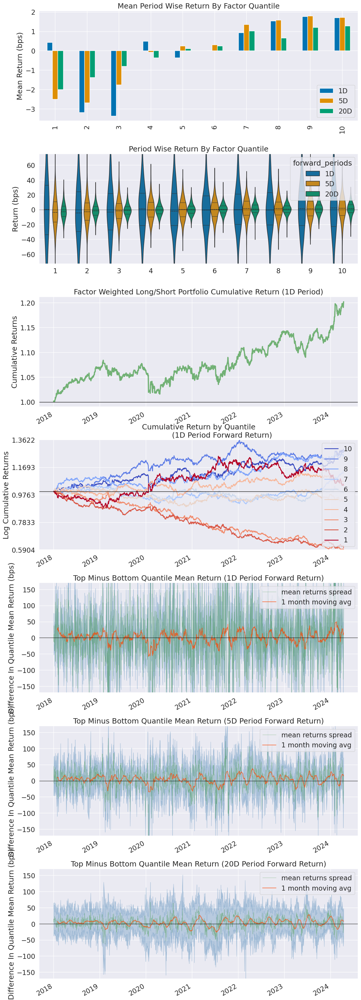

Information Analysis


,1D,5D,20D
IC Mean,0.029,0.040,0.047
IC Std.,0.089,0.085,0.087
Risk-Adjusted IC,0.322,0.468,0.542
t-stat(IC),12.555,18.280,21.147
p-value(IC),0.000,0.000,0.000
IC Skew,-0.027,-0.077,-0.022
IC Kurtosis,0.030,0.114,0.169


/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


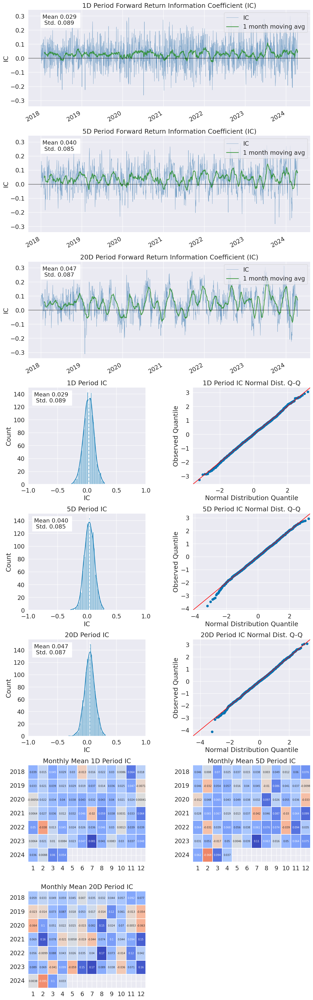

/root/anaconda3/envs/happyquant/lib/python3.10/site-packages/alphalens/utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,20D
Quantile 1 Mean Turnover,0.831,0.858,0.869
Quantile 2 Mean Turnover,0.876,0.883,0.888
Quantile 3 Mean Turnover,0.889,0.891,0.894
Quantile 4 Mean Turnover,0.895,0.898,0.898
Quantile 5 Mean Turnover,0.898,0.900,0.901
Quantile 6 Mean Turnover,0.897,0.901,0.902
Quantile 7 Mean Turnover,0.894,0.897,0.898
Quantile 8 Mean Turnover,0.890,0.892,0.895
Quantile 9 Mean Turnover,0.876,0.883,0.886
Quantile 10 Mean Turnover,0.841,0.854,0.864


,1D,5D,20D
Mean Factor Rank Autocorrelation,0.188,0.137,0.11


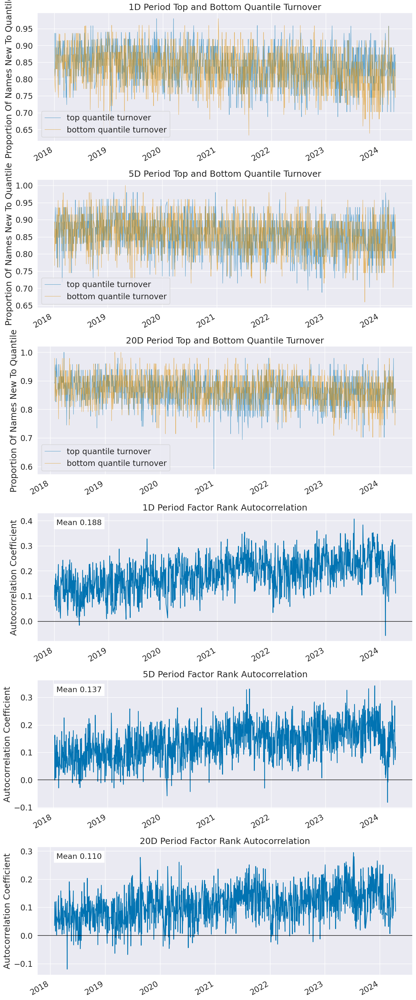

In [12]:
for column in df_factors.columns[1:]:
    print(f"============= {column} ===========")
    factor_data = al.utils.get_clean_factor_and_forward_returns(
        factor=-df_factors[column],
        prices=prices,
        quantiles=10,
        periods=(1, 5, 20),
    )
    al.tears.create_full_tear_sheet(factor_data, long_short=True, group_neutral=False, by_group=False)